# Examples of usage

Import necessery packages and define exemplary probability density functions to sample from

1. `Uniform` proposal distribution is more mature and works better in higher dimesions
2. `MetropolisHastingsSymmetric` is a refined version of `MetropolisHastings` to work with symmetric proposal distributions and allows to sample faster from them
3. `Auto` function provides wrapper to sample from custom pdf function without need to worry about setting proposal distribution and its paramters

In [1]:
# !pip install pingouin # for statistical tests

In [2]:
import numpy as np
import pingouin as pg
import matplotlib.pyplot as plt
from ProposalDistribution import Normal, Uniform
from Sampling import MetropolisHastingsSymmetric, MetropolisHastings
from Auto import AutoSample

In [3]:
np.random.seed(1234)

In [4]:
# Exponential distribution
def exp_target(x):
    return np.where(x < 0, 0, np.exp(-x))

In [5]:
# 1-dimesional normal distribution
sigma = np.eye(N=1)
inv_1d = np.linalg.inv(sigma)
def norm_target_1d(x):
    return np.exp(-np.matmul(np.matmul(x, inv_1d),x.T)**2)

In [6]:
# 10-dimesional normal distribution
sigma = np.eye(N=10)
sigma[0, 0] = 10
inv = np.linalg.inv(sigma)
def norm_target_10d(x):
    return np.exp(-np.matmul(np.matmul(x, inv),x.T)**2)

Setup instances of proposal distributions and algorithms

In [7]:
uniform = Uniform(spread=0.1)
normal = Normal(mean=0, spread=1)

In [8]:
algo = MetropolisHastings(target=exp_target, proposal=normal, initial=[0])
algo_sym = MetropolisHastingsSymmetric(target=exp_target, proposal=normal, initial=[0])

Sample 10 000 points from exponential distribution, burn-in period is set to 1 000 (deafult)

In [9]:
sample = algo.run(size=10000, verbose=1)

Proportion of samples accepted: 51.72%


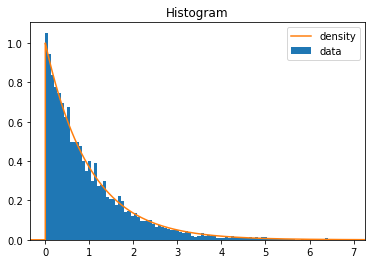

In [10]:
plt.hist(sample, density=True, bins=100, label='data')
mn, mx = plt.xlim()
plt.xlim(mn, mx)
plt.plot(np.linspace(mn, mx, 10000), exp_target(np.linspace(mn, mx, 10000)), label='density')
plt.title('Histogram')
plt.legend(loc='upper right')

Speed comparison between exploiting the symmetry in proposal distribution and not

In [11]:
%%timeit
algo.run(size=10000)

457 ms ± 26.4 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [12]:
%%timeit
algo_sym.run(size=10000)

236 ms ± 4.06 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


Quite nice!

Sample 10 000 points from univariate normal distribution and  test the normality

In [13]:
algo = MetropolisHastingsSymmetric(target=norm_target_1d, proposal=normal, initial=[0])

In [14]:
sample = algo.run(size=5000)

In [15]:
print(pg.normality(sample.flatten()))

          W          pval  normal
0  0.986458  1.652833e-21   False


Try again using thinning in the sample generation and breaking the corellation in the sample (sample should be taken 100 times bigger, but it takes a lot of time...)

In [16]:
sample = algo.run(size=5000, thinning=100)

In [17]:
print(pg.normality(sample.flatten()))

          W     pval  normal
0  0.982571  0.66423    True


Now, let try sample from the mulitvariate normal distribution using the Metropolis-Hastings algorithm. The uniform proposal distribution will be used. Additionaly, we will start from some random point and specify only the shape (dimension) of the target space.

In [18]:
algo = MetropolisHastingsSymmetric(target=norm_target_10d, proposal=uniform, shape=(10, ))

In [19]:
sample = algo.run(size=10000, verbose=1)

Proportion of samples accepted: 92.01%


Text(0.5, 1.0, '2-dimensional slice of 10-dimensional sample')

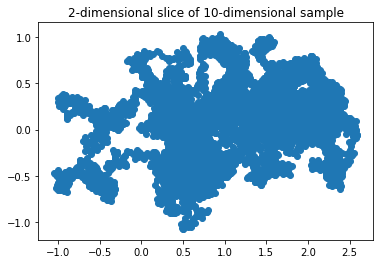

In [20]:
plt.scatter(sample[:, 0], sample[:, 1])
plt.title('2-dimensional slice of 10-dimensional sample')

The plot above definetely does not look like the normal sample! The problem is visible iin line 19, the proportion of accepted samples is to high and therefore the mixing in obtained chain is poor. Heuristically speaking, the proportion of accepted samples should be between 40% and 60%. We can try to obtain better results changing the `spread` (variability) in the proposal distribution.

In [21]:
uniform = Uniform(spread=2)
algo = MetropolisHastingsSymmetric(target=norm_target_10d, proposal=uniform, shape=(10, ))
sample = algo.run(size=10000, verbose=1)

Proportion of samples accepted: 3.55%


Text(0.5, 1.0, '2-dimensional slice of 10-dimensional sample')

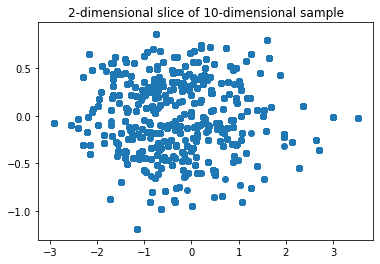

In [22]:
plt.scatter(sample[:, 0], sample[:, 1])
plt.title('2-dimensional slice of 10-dimensional sample')

Better, but still bad! This time the proportion of accepted samples is too low and most of the sample space has not been explored. The problem would be much worst if we would start far from the support of target distribution. We can try to furter change the variability in proposal distribution or we can just delegate this job to computer to look for some reasonable parameter.

Warning! This procedure utilizes multiprocessing via dask, by default it consumes all available CPU resources. This behaviour can be modified by paramter `njobs` set to the number of (logical) cores to be used by dask, -1 means "take everything!". The progress can be observed on a dask dashbord.

In [23]:
auto = AutoSample(target=norm_target_10d, shape=(10, ), njobs=-1)

Dashboard available under: http://127.0.0.1:8787/status


In [24]:
sample = auto.sample(size=10000)

Looking for a best sampler...
test_samplers ran in 6.806564807891846 s
Sampling...


Text(0.5, 1.0, '2-dimensional slice of 10-dimensional sample')

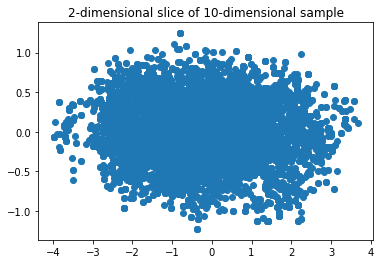

In [25]:
plt.scatter(sample[:, 0], sample[:, 1])
plt.title('2-dimensional slice of 10-dimensional sample')

In [26]:
print('Proportion of samples accepted: {}%'.format(auto.sampler.accepted))
print('Proposal distribution spread paramter: {}'.format(auto.sampler.proposal.spread))

Proportion of samples accepted: 50.370000000000005%
Proposal distribution spread paramter: 0.6247213938745548


Much better!

Using the AutoSampling functionality we can also sample multiple chaines at once, again using dask to distribute the work accross different cores.

In [27]:
auto = AutoSample(target=norm_target_10d, shape=(10, ), njobs=-1)
sample = auto.sample(size=10000, chains=10)

/home/grzegorz/anaconda3/envs/MCMC/lib/python3.8/site-packages/distributed/node.py:151: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 41811 instead
  warnings.warn(


Dashboard available under: http://127.0.0.1:41811/status
Looking for a best sampler...
test_samplers ran in 7.439439058303833 s
Sampling...


In [28]:
print('Sample shape: {}'.format(sample.shape)) # 10 chaines of length 10 000 of 10-dimensional samples

Sample shape: (10, 10000, 10)


Finally, we can observe the process of sampling using the Metropolis-Hastings algorithm in a case of funny distribution taken from J. Kaipo, E. Somersalo, "Statistical and Computational Inverse Problems" and specified up the a constant.

In [29]:
def smaile(x, y):
    return np.exp(-10*(x**2 - y)**2 - (y-0.25)**4)
def smaile_wrapper(x):
    return smaile(x[0], x[1])

In [30]:
uniform = Uniform(spread=0.5)
sampler = MetropolisHastingsSymmetric(target=smaile_wrapper, proposal=uniform, initial=np.array([-1.5, -1.5]))
sample = sampler.run(burnin=0, size=1000)

Text(0.5, 1.0, 'Smaile')

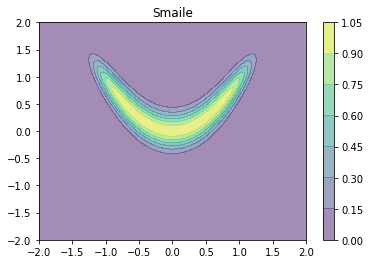

In [31]:
from matplotlib import animation, rc, rcParams
from IPython.display import HTML
rcParams['animation.embed_limit'] = 2**128

xlist = np.linspace(-2.0, 2.0, 100)
ylist = np.linspace(-2.0, 2.0, 100)
X, Y = np.meshgrid(xlist, ylist)
Z = smaile(X, Y)
fig,ax=plt.subplots(1,1)
cp = ax.contourf(X, Y, Z, alpha=0.5)
sc = ax.scatter([], [])
fig.colorbar(cp)
ax.set_title('Smaile')

In [32]:
def init():
    sc.set_offsets([])
    return (sc,)

def animate(i):
    sc.set_offsets(sample[:i])
    return (sc,)

# rendering may take a while
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=sample.shape[0], interval=20, 
                               blit=True)

In [33]:
%matplotlib inline
HTML(anim.to_jshtml())

The effect of different `spread` values is clearly visible using above animation
